In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix


In [48]:
data = pd.read_csv(
    "melb_data.csv"
)

In [49]:
data['Car'].fillna(value=0, inplace= True)

In [50]:
index_highprice = data[data['Price'] > (500 * 1e4)].index
data.drop(index_highprice, inplace=True)
del index_highprice

index_highroom = data[data['Rooms'] > 7].index
data.drop(index_highroom, inplace= True)
del index_highroom

index_highbedroom = data[data['Bedroom2'] > 7].index
data.drop(index_highbedroom, inplace = True)
del index_highbedroom

index_highDist = data[data['Distance'] > 35].index
data.drop(index_highDist, inplace = True)
del index_highDist

index_uselesspost = data[data['Postcode'] > 3250].index
data.drop(index_uselesspost, inplace = True)
del index_uselesspost


<AxesSubplot:xlabel='Price', ylabel='Car'>

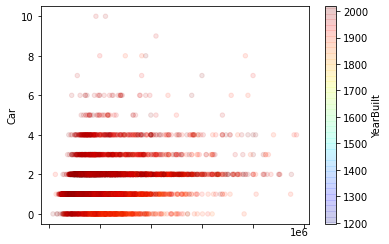

In [5]:
data.plot(
    x = 'Price',
    y = 'Car',
    kind = 'scatter',
    c = 'YearBuilt',
    cmap = plt.get_cmap('jet'),
    colorbar = True,
    alpha = 0.11
)

array([[<AxesSubplot:xlabel='Price', ylabel='Price'>,
        <AxesSubplot:xlabel='Rooms', ylabel='Price'>,
        <AxesSubplot:xlabel='Bedroom2', ylabel='Price'>,
        <AxesSubplot:xlabel='Bathroom', ylabel='Price'>,
        <AxesSubplot:xlabel='Car', ylabel='Price'>],
       [<AxesSubplot:xlabel='Price', ylabel='Rooms'>,
        <AxesSubplot:xlabel='Rooms', ylabel='Rooms'>,
        <AxesSubplot:xlabel='Bedroom2', ylabel='Rooms'>,
        <AxesSubplot:xlabel='Bathroom', ylabel='Rooms'>,
        <AxesSubplot:xlabel='Car', ylabel='Rooms'>],
       [<AxesSubplot:xlabel='Price', ylabel='Bedroom2'>,
        <AxesSubplot:xlabel='Rooms', ylabel='Bedroom2'>,
        <AxesSubplot:xlabel='Bedroom2', ylabel='Bedroom2'>,
        <AxesSubplot:xlabel='Bathroom', ylabel='Bedroom2'>,
        <AxesSubplot:xlabel='Car', ylabel='Bedroom2'>],
       [<AxesSubplot:xlabel='Price', ylabel='Bathroom'>,
        <AxesSubplot:xlabel='Rooms', ylabel='Bathroom'>,
        <AxesSubplot:xlabel='Bedroom2', ylabel

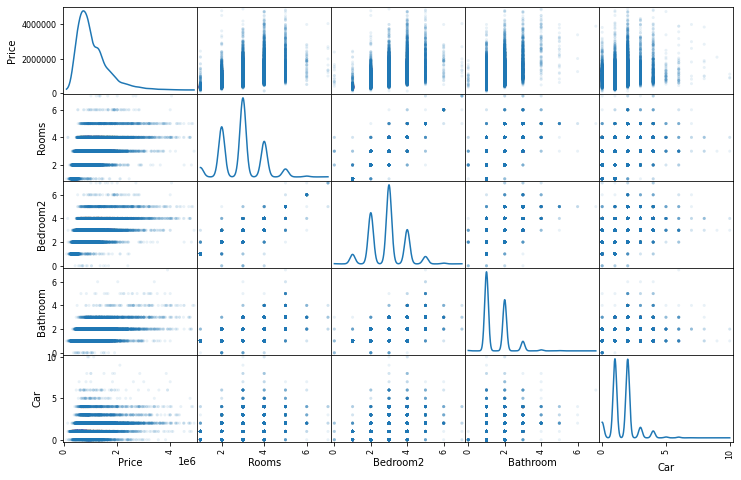

In [6]:
attributes = ['Price', 'Rooms', 'Bedroom2', 'Bathroom', 'Car']
scatter_matrix(data[attributes], figsize = (12, 8), diagonal='kde', alpha=0.1)

In [51]:
data.drop(columns=['Address'], inplace= True)

In [68]:
###### FILL_NA IN COUNCIL AREA USING POSTCODE


data.sort_values(by='Postcode', inplace=True, ignore_index=True)
data['CouncilArea'].fillna(method='ffill', inplace=True)

In [69]:
data.to_csv('Clean melb_data.csv')